# Basic Image Processing

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go

## Loading an Image and it's Dimensions

In [2]:
img_lena = cv2.imread("img/lena.png")
img_lena.shape

(512, 512, 3)

## Loading All Channels of an Image

In [3]:
img2 = cv2.imread("img/chair.png", cv2.IMREAD_UNCHANGED)
img2.shape

(137, 137, 4)

## Displaying the Alpha Channel

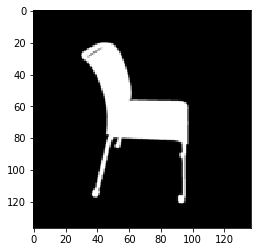

In [4]:
plt.imshow(cv2.cvtColor(img2[:,:,3], cv2.COLOR_RGB2BGR))

# cv2.imshow("chair-mask", img2[:,:,3])
# cv2.waitKey(0)
# cv2.destroyAllWindows()

## Shifting Colors

Text(0.5, 1.0, 'Correctly Shifted Image')

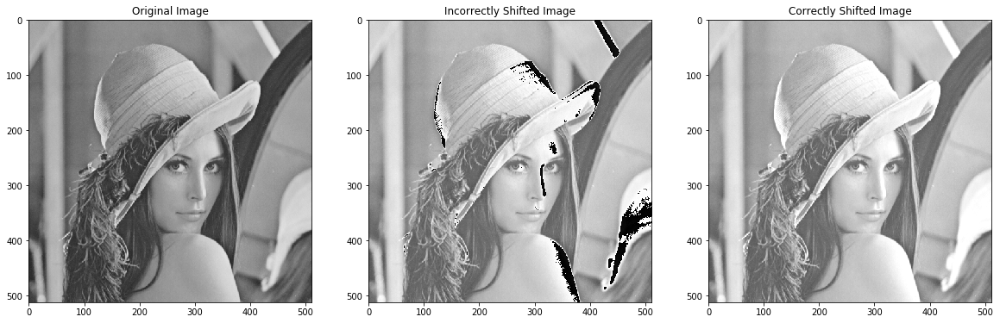

In [5]:
img_lena = cv2.imread("img/lena.png", cv2.IMREAD_GRAYSCALE)
img_lena1 = img_lena + 45
img_lena2 = np.clip(img_lena.astype('int64')+45,0,255).astype('uint8')

fig = plt.figure(figsize=(20,55))

plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(img_lena, cv2.COLOR_RGB2BGR))
plt.title("Original Image")
plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(img_lena1, cv2.COLOR_RGB2BGR)) 
plt.title("Incorrectly Shifted Image")
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(img_lena2, cv2.COLOR_RGB2BGR)) 
plt.title("Correctly Shifted Image")

# Power Law (Gamma) Transform

Gamma > 1 makes image darker <br>
Gamma < 1 makes image lighter

Text(0, 0.5, 'Output intensities')

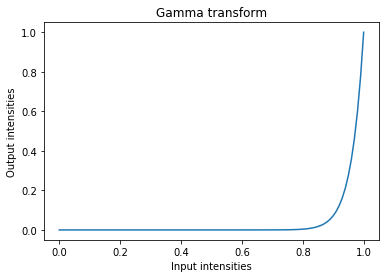

In [13]:
gamma = 25
x = np.linspace(0,1,num = 100)
y = x**gamma
plt.plot(x, y)
plt.title("Gamma transform")
plt.xlabel("Input intensities")
plt.ylabel("Output intensities")


Text(0, 0.5, 'Output intensities')

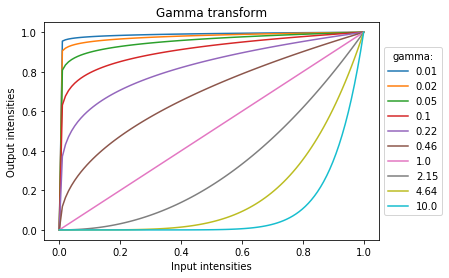

In [26]:
gamma = np.logspace(-2, 1, num = 10)
for g in gamma:
    plt.plot(x, x**g)

plt.legend(np.round(gamma,2), loc = 'center left',bbox_to_anchor=(1,0.5), title="gamma:")
plt.title("Gamma transform")
plt.xlabel("Input intensities")
plt.ylabel("Output intensities")

In [12]:
def gamma_transform(img, gamma):   
    return (((img.astype('int64')/255)**gamma)*255).astype('uint8')

### Image 1 [Q1(a)]

Text(0.5, 1.0, 'gamma = 0.7')

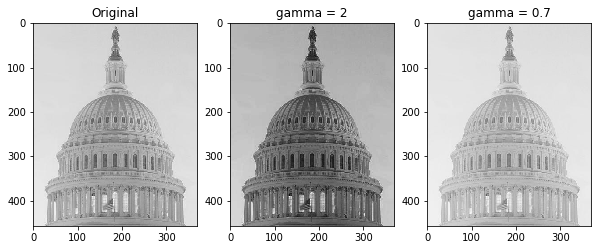

In [8]:
img_g1 = cv2.imread("img/gamma1.jpg")

fig = plt.figure(figsize = (10,50))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(img_g1, cv2.COLOR_RGB2BGR))
plt.title("Original")
plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(gamma_transform(img_g1, 2), cv2.COLOR_RGB2BGR))
plt.title("gamma = 2")
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(gamma_transform(img_g1, 0.7), cv2.COLOR_RGB2BGR))
plt.title("gamma = 0.7")

### Image 2 [Q1(b)]

Text(0.5, 1.0, 'gamma = 0.4')

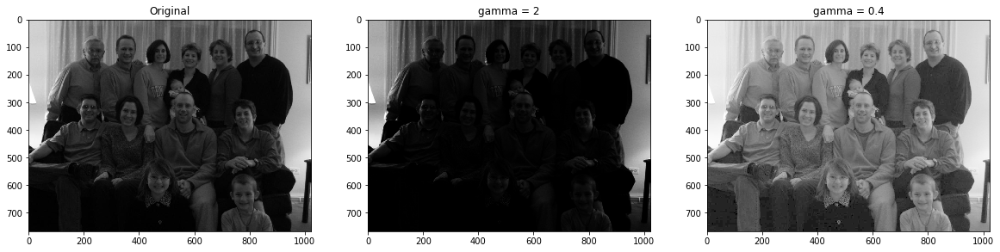

In [9]:
img_g2 = cv2.imread("img/gamma2.jpg")

fig = plt.figure(figsize = (20,90))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(img_g2, cv2.COLOR_RGB2BGR))
plt.title("Original")
plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(gamma_transform(img_g2, 2), cv2.COLOR_RGB2BGR))
plt.title("gamma = 2")
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(gamma_transform(img_g2, 0.4), cv2.COLOR_RGB2BGR))
plt.title("gamma = 0.4")

## Histograms

### B&W Histograms

In [10]:
def plot_hist(img):
    plt.hist(img.flatten(), bins=256)
    plt.title("Image Histogram (B&W)")
    
def plotly_hist(img):
    fig = go.Figure()
    fig.add_trace(go.Histogram(x = img.flatten()))
    fig.show()

#### Bruteforcing

Text(0.5, 1.0, 'Image Histogram (B&W)')

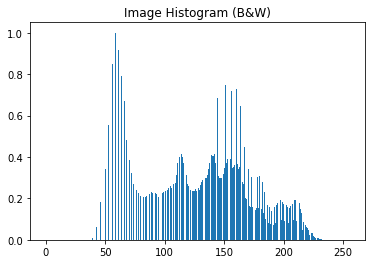

In [11]:
img_lena = cv2.imread("img/lena.png", cv2.IMREAD_GRAYSCALE)
# brute force implementation for histogram
count = [0 for i in range(256)]
for i in img_lena.flatten():
    count[i] += 1

plt.bar(range(256),np.array(count)/max(count))
plt.title("Image Histogram (B&W)")

#### Using custom vector functions

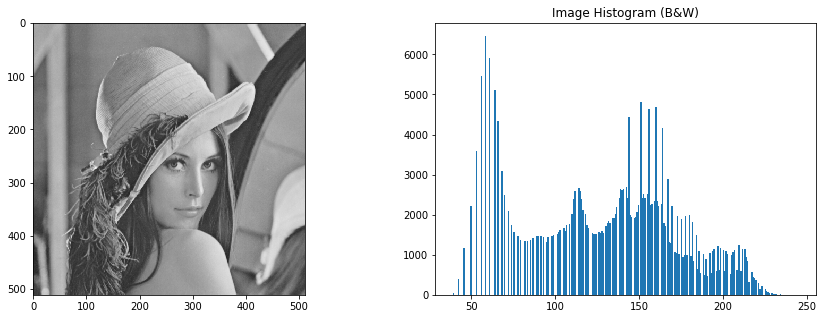

In [12]:

fig = plt.figure(figsize = (15,5))
plt.subplot(121)
plt.imshow(cv2.cvtColor(img_lena, cv2.COLOR_RGB2BGR))
plt.subplot(122)
plot_hist(img_lena)
plotly_hist(img_lena)

### RGB Histograms

In [13]:
def plot_color_hist(img):
    
    plt.title("Histogram(RGB)")
    plt.hist(img[:,:,0].flatten(), bins = 256, color="red", alpha = 0.4)
    plt.hist(img[:,:,1].flatten(), bins = 256, color="green", alpha = 0.4)
    plt.hist(img[:,:,2].flatten(), bins = 256, color="blue", alpha = 0.4)
    
    plt.show()
    
def plotly_color_hist(img):
    
    fig = go.Figure()
    fig.add_trace(go.Histogram(x = img[:,:,0].flatten()))
    fig.add_trace(go.Histogram(x = img[:,:,1].flatten()))
    fig.add_trace(go.Histogram(x = img[:,:,2].flatten()))
    
    fig.show()

### Lena RGB Histogram

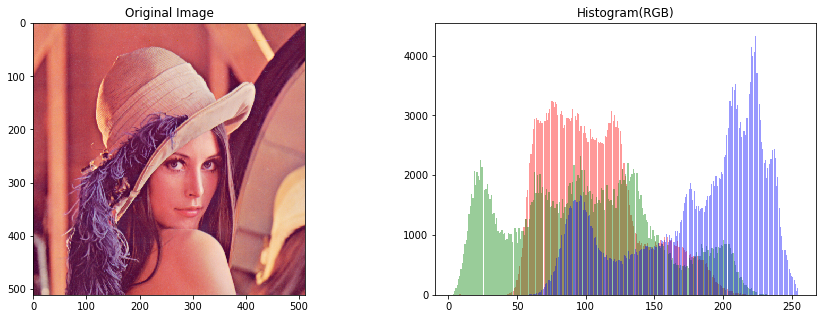

In [14]:
img_color = cv2.imread("img/lena.png")

fig = plt.figure(figsize = (15,5))
plt.subplot(121)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img_color, cv2.COLOR_RGB2BGR))
plt.subplot(122)
plot_color_hist(img_color)
plotly_color_hist(img_color)

### Lotus RGB Histogram [Q2]

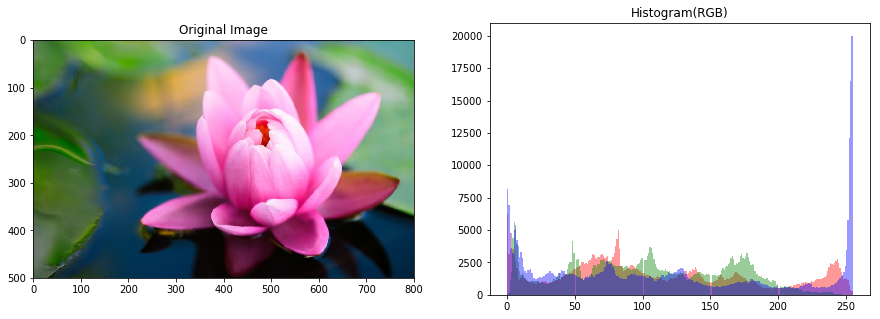

In [15]:
img_color = cv2.imread("img/lotus.jpg")

fig = plt.figure(figsize = (15,5))
plt.subplot(121)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img_color, cv2.COLOR_RGB2BGR))
plt.subplot(122)
plot_color_hist(img_color)
plotly_color_hist(img_color)

## Thresholding

In [16]:
def threshold(img, a):
    return ((img > a) * 255).astype('uint8')

### Image 1

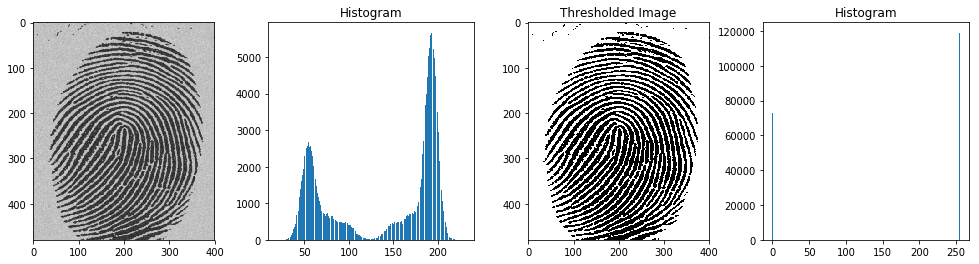

In [17]:
img_thres = cv2.imread("img/FingerPrint.jpg", cv2.IMREAD_GRAYSCALE)

fig = plt.figure(figsize=(17,4))
plt.subplot(141)
plt.imshow(cv2.cvtColor(img_thres, cv2.COLOR_RGB2BGR))
plt.subplot(142)
plot_hist(img_thres)
plt.title("Histogram")
plt.subplot(143)
plt.imshow(cv2.cvtColor(threshold(img_thres, 127), cv2.COLOR_RGB2BGR))
plt.title("Thresholded Image")
plt.subplot(144)
plot_hist(threshold(img_thres, 127))
plt.title("Histogram")
plt.show()

### Image 2

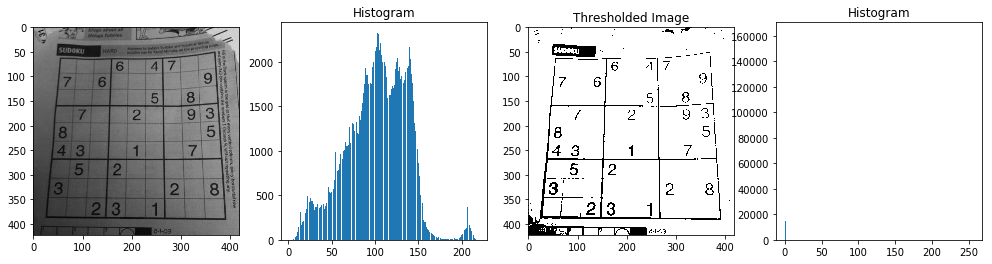

In [18]:
img_thres2 = cv2.imread("img/Sudoku.jpeg", cv2.IMREAD_GRAYSCALE)
thres = 50

fig = plt.figure(figsize=(17,4))
plt.subplot(141)
plt.imshow(cv2.cvtColor(img_thres2, cv2.COLOR_RGB2BGR))
plt.subplot(142)
plot_hist(img_thres2)
plt.title("Histogram")
plt.subplot(143)
plt.imshow(cv2.cvtColor(threshold(img_thres2, thres), cv2.COLOR_RGB2BGR))
plt.title("Thresholded Image")
plt.subplot(144)
plot_hist(threshold(img_thres2, thres))
plt.title("Histogram")
plt.show()

### Image 3 [Q3]

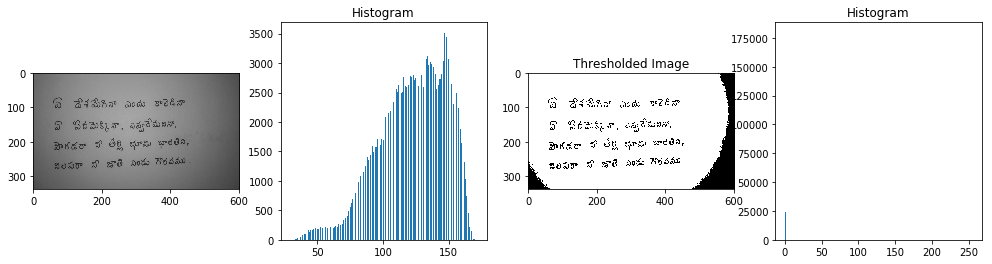

In [19]:
img_thres3 = cv2.imread("img/text.jpg", cv2.IMREAD_GRAYSCALE)
thres = 90

fig = plt.figure(figsize=(17,4))
plt.subplot(141)
plt.imshow(cv2.cvtColor(img_thres3, cv2.COLOR_RGB2BGR))
plt.subplot(142)
plot_hist(img_thres3)
plt.title("Histogram")
plt.subplot(143)
plt.imshow(cv2.cvtColor(threshold(img_thres3, thres), cv2.COLOR_RGB2BGR))
plt.title("Thresholded Image")
plt.subplot(144)
plot_hist(threshold(img_thres3, thres))
plt.title("Histogram")
plt.show()

## Filters

### Filtering using Convolution

In [20]:
def conv(H, img, x, y):
    
    ans = 0;
    for i in range(-1,2):
        for j in range(-1,2):
            ans += H[i+1][j+1]*img[x+i][y+j]
    
    return ans

def average_filter(img, H):
    a, b = img.shape
    for i in range(a):
        for j in range(b):
            if (i in [0,a-1] or j in [0, b-1]):
                continue
            else:
                img[i][j] = conv(H, img, i, j)
                
    return img


### Averaging Filter

Text(0.5, 1.0, 'On Applying Averaging Filter Few Times')

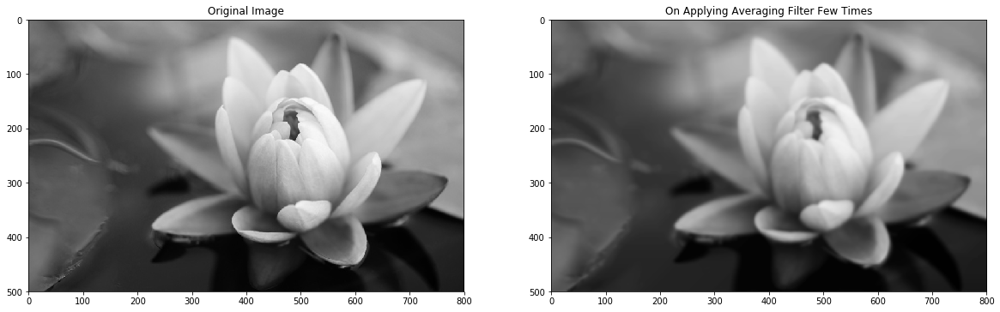

In [21]:
H = np.array([
    [1,1,1],
    [1,1,1],
    [1,1,1]])/9


img_bw = cv2.imread("img/lotus.jpg", cv2.IMREAD_GRAYSCALE)
new_img = cv2.imread("img/lotus.jpg", cv2.IMREAD_GRAYSCALE) 
new_img = average_filter(new_img, H)
new_img = average_filter(new_img, H)
new_img = average_filter(new_img, H)
new_img = average_filter(new_img, H)
new_img = average_filter(new_img, H)

fig = plt.figure(figsize = (20,90))
plt.subplot(121)
plt.imshow(cv2.cvtColor(img_bw, cv2.COLOR_RGB2BGR))
plt.title("Original Image")
plt.subplot(122)
plt.imshow(cv2.cvtColor(new_img, cv2.COLOR_RGB2BGR))
plt.title("On Applying Averaging Filter Few Times")

### Counting Number of Windows in the Image [Q4]

In [22]:
img_org = cv2.imread("img/window.jpeg")

sobel_v = np.array([
    [-1,0,1],
    [-2,0,2],
    [-1,0,1]
])
sobel_h = np.array([
    [1,2,1],
    [0,0,0],
    [-1,-2,-1]
])

14 10
Number of windows = 140


Text(0.5, 1.0, 'Vertical Lines')

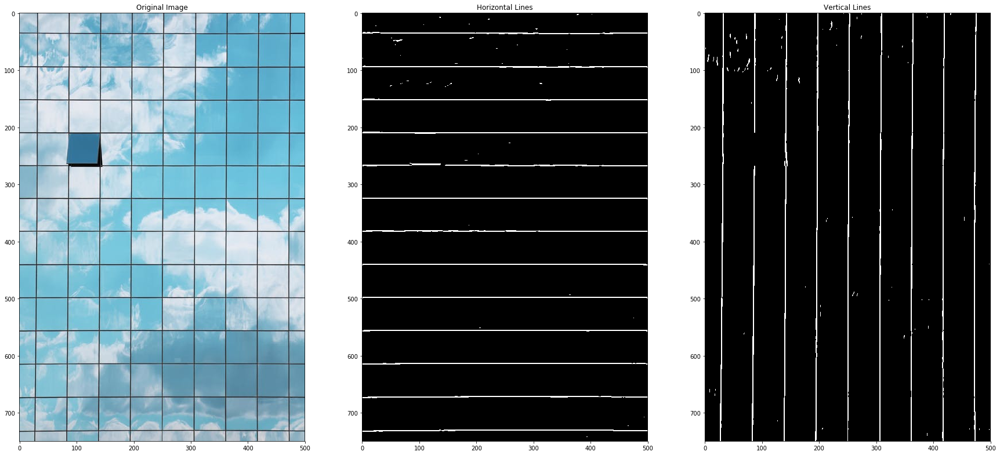

In [23]:
img = cv2.imread("img/window.jpeg", cv2.IMREAD_GRAYSCALE)
img = average_filter(img, H)

edges_x = cv2.filter2D(img, -1, sobel_h)
edges_y = cv2.filter2D(img, -1, sobel_v)
_, edges_x = cv2.threshold(cv2.filter2D(edges_x, -1, sobel_h), 200, 255, cv2.THRESH_BINARY)
_, edges_y = cv2.threshold(cv2.filter2D(edges_y, -1, sobel_v), 200, 255, cv2.THRESH_BINARY)

count_x = 0
count_y = 0
for i in edges_y[190]:
    if i == 255:
        count_x += 1
v_lines = (round(count_x/2))

for i in range(edges_x.shape[0]):
    if edges_x[i][150] >= 250:
        count_y += 1
h_lines = (round(count_y/2))

#Division by 2 as each line is 2 pixels wide(found experimentally)

print(h_lines, v_lines)
print("Number of windows =", v_lines*h_lines)
    
fig = plt.figure(figsize = (30,90))
    
plt.subplot(131)
plt.imshow(cv2.cvtColor(img_org, cv2.COLOR_RGB2BGR))
plt.title("Original Image")
plt.subplot(132)
plt.imshow(cv2.cvtColor(edges_x, cv2.COLOR_RGB2BGR))
plt.title("Horizontal Lines")
plt.subplot(133)
plt.imshow(cv2.cvtColor(edges_y, cv2.COLOR_RGB2BGR))
plt.title("Vertical Lines")